# EEG epilepszia detektálás

## Bevezető

Epilepsziás roham előrejelzést biztosító rendszerek ígéretesen növelhetik az epilepszában szenvedő betegek életszínvonalát.

Az emberiség szinte 1%-a tapasztal spontán epilepsziás rohamokat. Sokuk kellő nagy mennyiségű gyógyszer segítségével a rohamokat megelőzik, viszont a gyógyszerek mellékhatása kihatással van az életükre. A betegek 20-40%-án nem hatásosak a gyógyszerek.

Ha kellő megbízhatóságú rendszerek segítségével tudnánk az epilepszia rohamra hajlamos agyi állapotot azonosítani, akkor a beteget erről figyelmeztetni tudnánk. Így a beteg elkerülheti a veszélyes foglalkozásokat, illetve célzottan alkalmazhatja a kellő gyógyszereket, így csökkentve a mellékhatásukat.

Kellő bizonyíték létezik, miszerint az agy működését 4 fázisba sorolhatjuk: Interictal (rohamok között, alapműködés), Preictal (roham előtt), Ictal (roham közben), Postictal (roham után). Ahhoz, hogy előrejelezzük az epilepsziás rohamot sikeresen meg kell különböztetnünk a preictal fázist az interictal, ictal és postictal fázisoktól. A legnagyobb kihívás a preictal és interictal közti megkülönböztetés.

A feladat az, hogy sikeresen osztályozzuk a preictal agyi működést epilepsziás kutyáknál és embereknél.

Dataset: https://www.kaggle.com/competitions/seizure-prediction/data

EEG Toolkit: https://slopezpereyra.github.io/EEGToolkit.jl/dev/

In [ ]:
readdir()

4-element Vector{String}:
 ".config"
 "Dog_1_interictal_segment_0052.mat"
 "Dog_1_preictal_segment_0001.mat"
 "sample_data"

In [ ]:
import Pkg;
Pkg.add("MAT");
Pkg.add("EEGToolkit");
Pkg.add("Plots");
Pkg.add("Statistics");

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
   Installed Hwloc_jll ───────── v2.12.0+0
   Installed OpenMPI_jll ─────── v5.0.7+1
   Installed MPICH_jll ───────── v4.3.0+1
   Installed MPIPreferences ──── v0.1.11
   Installed HDF5_jll ────────── v1.14.6+0
   Installed MicrosoftMPI_jll ── v10.1.4+3
   Installed BufferedStreams ─── v1.2.2
   Installed MAT ─────────────── v0.10.7
   Installed libaec_jll ──────── v1.1.3+0
   Installed MPItrampoline_jll ─ v5.5.3+0
   Installed HDF5 ────────────── v0.17.2
    Updating `~/.julia/environments/v1.10/Project.toml`
  [23992714] + MAT v0.10.7
    Updating `~/.julia/environments/v1.10/Manifest.toml`
  [e1450e63] + BufferedStreams v1.2.2
  [f67ccb44] + HDF5 v0.17.2
  [23992714] + MAT v0.10.7
  [3da0fdf6] + MPIPreferences v0.1.11
  [0234f1f7] + HDF5_jll v1.14.6+0
  [e33a78d0] + Hwloc_jll v2.12.0+0
  [7cb0a576] + MPICH_jll v4.3.0+1
  [f1f71cc9] + MPItrampoline_jll v5.5.3+0
  [9237b28f] + MicrosoftMPI_jll

In [ ]:
using MAT
using EEGToolkit
using Plots
using Statistics

In [ ]:
struct CustomEEG
  signals::Dict{String, TimeSeries}
end

In [ ]:
function load_eeg(file::String, segment_name::String)
  file = matopen(file)
  segment = read(file, segment_name)
  close(file)

  eeg_data         = segment["data"]
  data_length_sec  = segment["data_length_sec"]
  sampling_freq    = segment["sampling_frequency"]
  channels         = segment["channels"]
  sequence         = segment["sequence"]

  signals = Dict{String, TimeSeries}()

  for i in 1:size(channels, 2)
      channel_label = channels[1, i]
      signals[channel_label] = TimeSeries(eeg_data[i, :], round(sampling_freq))
  end

  return CustomEEG(signals)
end

load_eeg (generic function with 1 method)

In [ ]:
eeg = load_eeg("Dog_1_interictal_segment_0052.mat", "interictal_segment_52");

Custom plot, based on the official plot_eeg

In [ ]:
function plot_custom_eeg(eeg::CustomEEG, s::Integer, e::Integer;
                         channels::Vector{String} = String[],
                         spacing::AbstractFloat = 1.5)

    if !isempty(channels) && any(ch -> ch ∉ keys(eeg.signals), channels)
        throw(ArgumentError("Attempting to plot a non-existent channel."))
    end

    signal_dict = isempty(channels) ? eeg.signals : Dict(k => v for (k, v) in eeg.signals if k in channels)
    L = length(signal_dict)

    p = plot(ylabel="Amplitude (µV)", xlabel="Time(s)", yticks=(1:L, collect(keys(signal_dict))), legend=false)

    for (i, (label, signal)) in enumerate(signal_dict)
        segment_start = s * signal.fs + 1
        segment_end = e * signal.fs
        if segment_start > length(signal.x) || segment_end > length(signal.x)
            throw(ArgumentError("Specified epoch range is out of bounds for signal length."))
        end
        segment = signal.x[segment_start:segment_end]

        t = range(start=s, stop=e, length=length(segment))

        normalized_signal = (segment .- mean(segment)) ./ (spacing * (2 * L) * std(segment))

        plot!(p, t, i .+ normalized_signal, label=label, color="blue")
    end

    return p
end

plot_custom_eeg (generic function with 1 method)

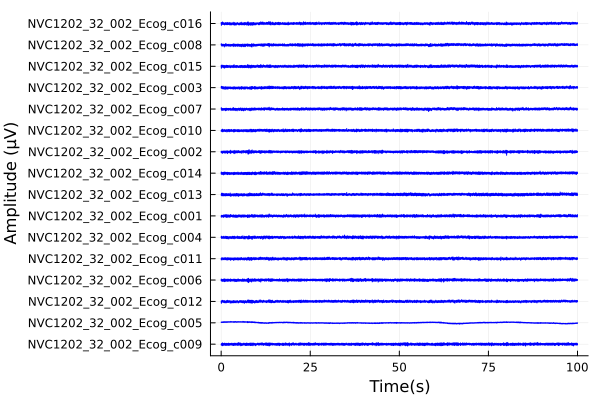

In [ ]:
display(plot_custom_eeg(eeg, 0, 100))

In [ ]:
savefig("interictal_0_100.png")

"/content/interictal_0_100.png"

In [ ]:
eeg_preictal = load_eeg("Dog_1_preictal_segment_0001.mat", "preictal_segment_1");

In [ ]:
display(plot_custom_eeg(eeg_preictal, 0, 100))

In [ ]:
savefig("preictal_0_100.png")

"/content/preictal_0_100.png"

In [ ]:
function plot_single_eeg(eeg::CustomEEG, s::Integer, e::Integer,
                         channel::String, spacing::AbstractFloat = 1.5)

    if channel ∉ keys(eeg.signals)
        throw(ArgumentError("Attempting to plot a non-existent channel."))
    end

    p = plot(ylabel="Amplitude (µV)", xlabel="Time(s)", legend=false, ylimits=(-2, 2))

    signal = eeg.signals[channel]
    segment_start = s * signal.fs + 1
    segment_end = e * signal.fs
    if segment_start > length(signal.x) || segment_end > length(signal.x)
        throw(ArgumentError("Specified epoch range is out of bounds for signal length."))
    end
    segment = signal.x[segment_start:segment_end]
    t = range(start=s, stop=e, length=length(segment))
    normalized_signal = (segment .- mean(segment)) ./ (spacing * 2 * std(segment))

    plot!(p, t,normalized_signal, title=channel, color="blue")
    return p
end

plot_single_eeg (generic function with 2 methods)

In [ ]:
keys(eeg.signals)

KeySet for a Dict{String, TimeSeries} with 16 entries. Keys:
  "NVC1202_32_002_Ecog_c009"
  "NVC1202_32_002_Ecog_c005"
  "NVC1202_32_002_Ecog_c012"
  "NVC1202_32_002_Ecog_c006"
  "NVC1202_32_002_Ecog_c011"
  "NVC1202_32_002_Ecog_c004"
  "NVC1202_32_002_Ecog_c001"
  "NVC1202_32_002_Ecog_c013"
  "NVC1202_32_002_Ecog_c014"
  "NVC1202_32_002_Ecog_c002"
  "NVC1202_32_002_Ecog_c010"
  "NVC1202_32_002_Ecog_c007"
  "NVC1202_32_002_Ecog_c003"
  "NVC1202_32_002_Ecog_c015"
  "NVC1202_32_002_Ecog_c008"
  "NVC1202_32_002_Ecog_c016"

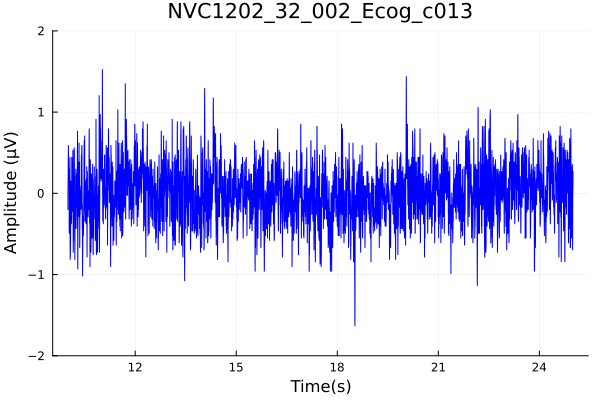

In [ ]:
display(plot_single_eeg(eeg, 10, 25, "NVC1202_32_002_Ecog_c013")) #collect(keys(eeg.signals))[1]))

In [ ]:
savefig("interictal_c13_10_25.png")

"/content/interictal_c13_10_25.png"

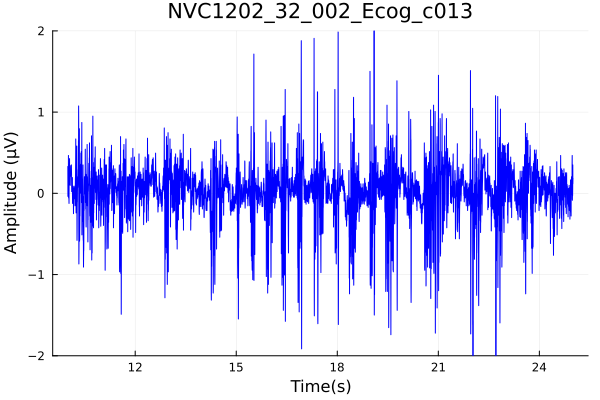

In [ ]:
display(plot_single_eeg(eeg_preictal, 10, 25, "NVC1202_32_002_Ecog_c013"))

In [ ]:
savefig("preictal_c13_10_25.png")

"/content/preictal_c13_10_25.png"

## **Feladat megfogalmazása:**



**Célunk:** egy neurális hálózat betanítása epilepsziás rohamok előrejelzésére EEG-adatok alapján. Ehhez intracraniális EEG-felvételek állnak rendelkezésünkre, amelyek fájlonként egy-egy 10 perces időszegmenst tartalmaznak. A rendelkezésünkre álló adathalmaz 5 kutyától és 2 emberi pácienstől származnak. Az EEG-felvételek két kategóriába vannak sorolva:

  - Interictal (nem rohamos) szegmensek: olyan időszakok, amikor nem történt roham. Ezeket kutyáknál legalább 1 héttel a roham előtt vagy után, embereknél pedig legalább 4 órával a roham előtt vagy után rögzítették.
  - Preictal (roham előtti) szegmensek: a roham előtti időszakból származó időszakok, amelyek 1 óra 5 perccel és 5 perccel a roham előtt készültek. Az 5 perces kihagyás célja, hogy a modell még a roham tényleges kialakulása előtt jelezni tudja a veszélyt, lehetőséget adva az időben történő beavatkozásra.

A mintavételezési frekvencia (sampling frequency) kutyáknál 400 Hz – azaz másodpercenként 400 mintavétel csatornánként, embereknél 5000 Hz.

Az adatok között a már kategóriába sorolt EEG-szegmensek mellett olyan tesztadatok is találhatóak, amelyek besorolása még ismeretlen, és a betanított modellnek kell eldöntenie, hogy interictal vagy preictal kategóriába tartoznak.

Az EEG-adatállomány összesítése:
  - Kutyákról 7529 darab 10 perces szegmens található, melyből 3672 interictal, 265 preictal és 3590 tesztfájl.
  - Emberekről 473 szegmens található, melyből 92 interictal, 36 preictal és 345 címkézésre váró tesztfájl.

## **Végrehajtási terv**:

  - EEG-adatok betöltése és vizualizációja:
       - Az adatállományok beolvasása és elemzése
       - Az EEG-jelek grafikus megjelenítése, hogy jobban megértsük a különbségeket az egyes kategóriák között.
  - Neurális háló betanítása:
       - Egy előre betanított neurális háló (pretrained model) finomhangolása az EEG-adatainkra.
       - Az adatainkat feloszása tanító(train), validációs(validation) és teszt(test) halmazokra.
  - Jellemzők kiválasztása (feature extraction) és a modell fejlesztése:
      - Alapvető jellemzők vizsgálata, mint például:
          - minimális és maximális feszültségértékek minden EEG-csatornán
          - szórás (standard deviation) kiszámítása csatornánként.
      - Spektrális jellemzők kinyerése Fourier-transzformációval, amely
segít az EEG-jelek időfüggetlen elemzésében és a különböző  frekvenciasávok teljesítményének kiértékelésében.
  - A modell kiértékelése:
      - A tesztadatok címkézése a betanított modell segítségével.
      - Különböző hálóarchitektúrák teljesítményének összehasonlítása.

